# Upscale Images with Pre-trained `super-image` Models

---

[Github](https://github.com/eugenesiow/super-image) | All Models @ [huggingface.co](https://huggingface.co/models?filter=super-image)

---

Notebook to use the `super-image` library to quickly upscale and image.

The technique used is applying a pre-trained deep-learning model to restore a high resolution (HR) image from a single low resolution (LR) image. This is also called image super resolution.

The notebook is structured as follows:
* Setting up the Environment
* Using the Model (Running Inference)

## Setting up the Environment

#### Install the library

We will install the `super-image` library using `pip install`.

In [1]:
!pip install -qq super-image

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.0/91.0 kB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 66.0 MB/s eta 0:00:00


In [3]:
import os

## Using the Model (Running Inference)

Next we run a few lines of code to:

* `Image.open` and `requests.get` - Download an image from a URL (website) and store this as the `image` variable.
* `EdsrModel.from_pretrained` - Download and load a small, pre-trained deep-learning model to the `model` variable.
* `ImageLoader.load_image` - Load the image into the `model` using the `ImageLoader` helper.
* Use the model to run inference on the image (`inputs`).
* `ImageLoader.save_image` - Save the upscaled image output as a `.png` file using the `ImageLoader` helper.
* `ImageLoader.save_compare` - Save a `.png` that compares our upscaled image from the model with a baseline image using `Bicubic` upscaling.

In [ ]:
from super_image import EdsrModel, ImageLoader
from PIL import Image, ImageFilter, ImageEnhance
# import requests
import numpy as np
import cv2

# url = 'https://paperswithcode.com/media/datasets/Set5-0000002728-07a9793f_zA3bDjj.jpg'
# image = Image.open(requests.get(url, stream=True).raw)
image = Image.open('table.png')
sharpen_kernel = [
    -1, -1, -1,
    -1, 9, -1,
    -1, -1, -1
]

# Create a kernel filter
kernel = ImageFilter.Kernel((3, 3), sharpen_kernel, scale=None, offset=0)

# Apply the sharpen filter
sharpened_image = image.filter(kernel)

enhancer = ImageEnhance.Sharpness(sharpened_image)
enhanced_image = enhancer.enhance(2.0)
enhanced_image.save('enhanced_table.png')

model = EdsrModel.from_pretrained('eugenesiow/edsr-base', scale=4)
inputs = ImageLoader.load_image(enhanced_image)
preds = model(inputs)

ImageLoader.save_image(preds, './scaled_2x.png')
ImageLoader.save_compare(inputs, preds, './scaled_2x_compare.png')

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:671: FutureWarning: 'cached_download' is the legacy way to download files from the HF hub, please consider upgrading to 'hf_hub_download'
  warnings.warn(


https://huggingface.co/eugenesiow/edsr-base/resolve/main/pytorch_model_4x.pt


View the comparison image to see, visually, how our model performed (on the right) against the baseline bicubic method (left).

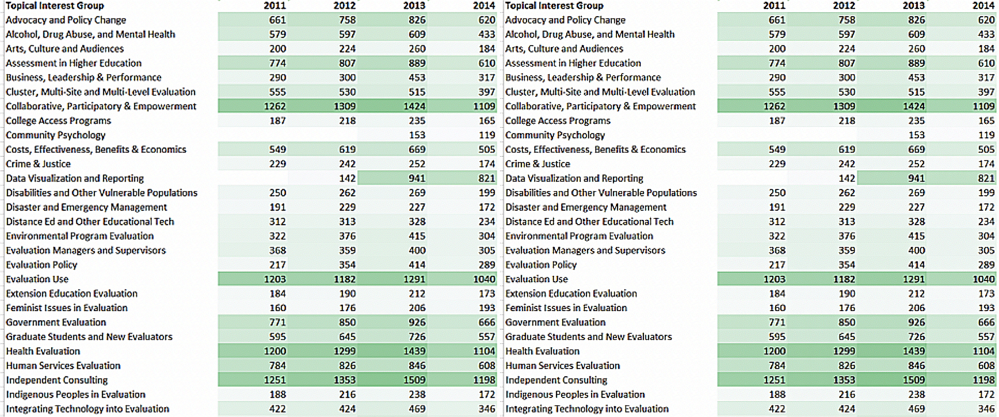

In [2]:
import cv2
from google.colab.patches import cv2_imshow

img = cv2.imread('./scaled_2x_compare.png')
cv2_imshow(img)

We can view the original image that we pulled from the URL/website using `cv2_imshow`.

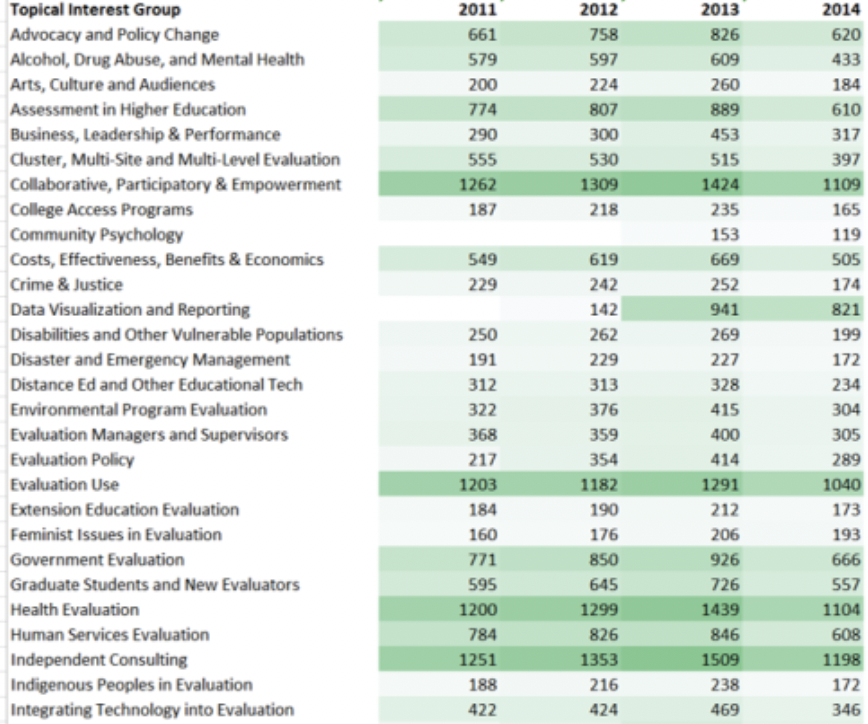

In [3]:
import numpy as np

cv2_imshow(cv2.cvtColor(np.array(image), cv2.COLOR_BGR2RGB))